In [1]:
import h5py as hp
%matplotlib inline
import matplotlib.pyplot as plt
import numpy as np
import hc_lib.plots.figlib as flib
import illustris_python as il
import matplotlib.gridspec as gspec
import matplotlib as mpl
import copy
tngpath = '/lustre/cosinga/L75n1820TNG/'
plt.rcParams['font.family'] = 'serif'
plt.rcParams['mathtext.fontset'] = 'dejavuserif'

/software/spack-software/2020.05.14/linux-rhel8-ivybridge/gcc-8.4.0/python-3.7.7-zgcjuclie3fiis4ljkrfp4c4j6fkoa62/lib/python3.7/site-packages/statsmodels/tools/_testing.py:19: FutureWarning: pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.
  import pandas.util.testing as tm


In [2]:
box = 'tng100'
snap = [99]
axis = 0
res = 800
files = ['vngrid', 'hiptlgrid']
slices = []
for f in files:
    for s in snap:
        rlib = flib.load(box, s, axis, res, f)
        slices.extend(rlib.results['slice'])

In [3]:
for s in slices:
    if 'model' in s.props:
        if s.props['model'] == 'GD14':
            if s.props['space'] == 'real':
                gdreal = s
            else:
                gdred = s
    else:
        if s.props['space'] == 'real':
            vnreal = s
        else:
            vnred = s  
    

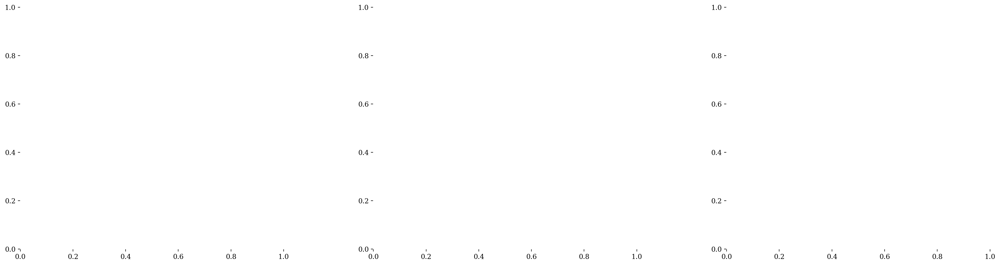

In [38]:
nrows = 1
ncols = 3
xborder = 1
yborder = 1
panel_bt = 2.5
panel_length = 5


# border input can be either a list or single number
if isinstance(xborder, float) or isinstance(xborder, int):
    xborder = [xborder, xborder]
if isinstance(yborder, float) or isinstance(yborder, int):
    yborder = [yborder, yborder]
if isinstance(panel_bt, float) or isinstance(panel_bt, int):
    panel_bt = [panel_bt, panel_bt]
# creating Figure object

figwidth = panel_length * ncols + panel_bt[0] * (ncols - 1) + \
        xborder[0] + xborder[1]
figheight = panel_length * nrows + panel_bt[1] * (nrows - 1) + \
        yborder[0] + yborder[1]

fig = plt.figure(figsize=(figwidth, figheight), dpi = 200)

# creating gridspec
gs = gspec.GridSpec(nrows, ncols)
plt.subplots_adjust(left= xborder[0]/figwidth, right=1-xborder[1]/figwidth,
        top=1-yborder[1]/figheight, bottom=yborder[0]/figheight,
        wspace=panel_bt[0]*ncols/figwidth, hspace=panel_bt[1]*nrows/figheight)

# making panels list
panels = []
for i in range(nrows):
    col_panels = []
    for j in range(ncols):
        col_panels.append(fig.add_subplot(gs[i, j]))

    panels.append(col_panels)

In [39]:
def avgmatrix(mat):
    mat = 10**mat
    mat = (mat[::2,:] + mat[1::2,:])
    mat = (mat[:, ::2] + mat[:, 1::2])
    return np.log10(mat)
def clear_axes():
    for i in range(nrows):
        for j in range(ncols):
            panels[i][j].clear()

    return


In [40]:
clear_axes()
plt.rcParams['axes.edgecolor'] = 'white'
fig.set_facecolor('black')
vlim = [2, 10]
norm = mpl.colors.Normalize(vmin=vlim[0], vmax=vlim[1])

cmap_name = 'plasma'
under = 'k'
cmap = copy.copy(mpl.cm.get_cmap(cmap_name))
cmap.set_under(under)
sm = mpl.cm.ScalarMappable(norm = norm, cmap = cmap)
slices = [vnreal, gdreal, vnred, gdred]
idxs = [(0,0), (0, 1), (1, 0), (1, 1)]
for i in range(2):
    rc = slices[i]
    idx = idxs[i]
    xlim, ylim, data = rc.getValues()
    extent=(xlim[0], xlim[1], ylim[0], ylim[1])
            # x_bound, y_bound, mass = pslice.getValues()
            # extent=(x_bound[0], x_bound[1], y_bound[0], y_bound[1])
    mask = data < norm.vmin
    data[mask] = norm.vmin

    panels[idx[0]][idx[1]].imshow(data, cmap = cmap, norm = norm, aspect = 'auto', extent=extent, 
            origin='lower')

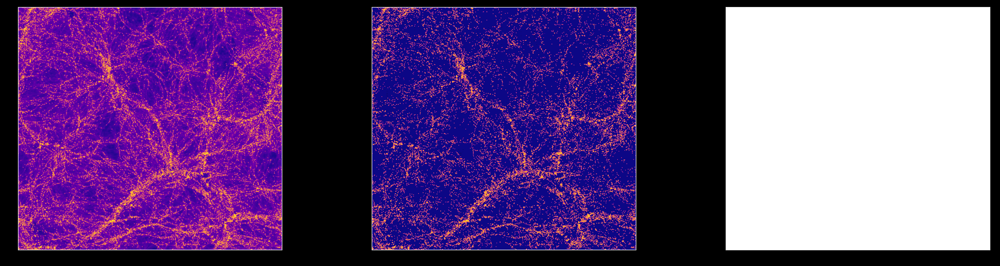

In [41]:
fig

In [42]:
# f = il.groupcat.loadSubhalos(tngpath+'output/',99, fields=['SubhaloPos', 'SubhaloVel'])
# h = hp.File(tngpath+'postprocessing/hih2/hih2_galaxy_099.hdf5', 'r')
# head = il.groupcat.loadHeader(tngpath+'output/',99)
# ids = h['id_subhalo'][:]
# ids = ids.astype(np.int32)
# pos = f['SubhaloPos'][ids] / 1e3 * head['Time']
# vel = f['SubhaloVel'][ids]
# box = head['BoxSize']/1e3*head['Time']
# mnm = box/2 - box * 0.1
# mxm = box/2 + box * 0.1
# pos_mask = (pos[:,1]> mnm) & (pos[:,1]<mxm)
# x = pos[pos_mask, 2]
# y = pos[pos_mask, 0]
# mass=h['m_hi_GD14_map'][pos_mask]
# sm = mpl.cm.ScalarMappable(norm = norm, cmap = cmap)
# sizes = np.log10(mass)
# colors = np.zeros((sizes.shape[0],4))
# for s in range(len(sizes)):
#     colors[s,:] = sm.to_rgba(sizes[s])
# z_size_idx = np.log10(mass) < norm.vmin
# sizes = mass/np.max(mass) * 3
# sizes[z_size_idx] = 0


# panels[0][2].clear()
# panels[0][2].scatter(x, y, s=sizes, c=colors)
# panels[0][2].set_ylim(ylim[0], ylim[1])
# panels[0][2].set_xlim(xlim[0], xlim[1])
# backcolor = sm.to_rgba(norm.vmin)
# panels[0][2].set_facecolor(backcolor)

# hubble = head["HubbleParam"]*100 # defined using big H
# redshift = head['Redshift']
# boxsize = box
# factor = (1+redshift)/hubble
# rspos = copy.copy(pos)
# rspos[:,0] += vel[:,0]*factor

# # handle periodic boundary conditions
# rspos[:, 0] = np.where((rspos[:,0]>boxsize) | (rspos[:,0]<0), 
#         (rspos[:,0]+boxsize)%boxsize, rspos[:,0])

# rspos_mask = (rspos[:,1]> mnm) & (rspos[:,1]<mxm)
# x = rspos[rspos_mask, 2]
# y = rspos[rspos_mask, 0]
# mass=h['m_hi_GD14_map'][rspos_mask]
# sm = mpl.cm.ScalarMappable(norm = norm, cmap = cmap)
# sizes = np.log10(mass)
# colors = np.zeros((sizes.shape[0],4))
# for s in range(len(sizes)):
#     colors[s,:] = sm.to_rgba(sizes[s])
# z_size_idx = np.log10(mass) < norm.vmin
# sizes = mass/np.max(mass)
# sizes[z_size_idx] = 0

# panels[1][2].clear()
# panels[1][2].scatter(x, y, s=sizes, c=colors)
# panels[1][2].set_ylim(ylim[0], ylim[1])
# panels[1][2].set_xlim(xlim[0], xlim[1])
# panels[1][2].set_facecolor(backcolor)

In [43]:
fsize = 16
locs = [10,20,30,40,50,60,70]

for i in range(nrows):
    for j in range(ncols-1):
        p = panels[i][j]
        if j == ncols:
            p.tick_params(labelsize=fsize-2)
        else:
            ticks = p.get_xticks()
            tkw = {'direction' : 'in', 'top':False, 'right' : False, 'reset':True, 'length' : 5, 
                          'width':2,'labelsize':fsize,'colors':'white'}
#             if i == 0:
#                 tkw['labelbottom'] = False
#             if not j == 0:
#                 tkw['labelleft'] = False
            p.tick_params(**tkw)
            
            p.set_xticks(locs)
            p.set_yticks([0]+locs)

            cax = panels[0][2]

            cax.set_aspect(12, anchor='W')
        
cbar = fig.colorbar(sm, cax=cax)
cax.tick_params(labelsize=14, colors = 'white')
# cbar.set_label(r'M$_{\rm{HI}}$ / M$_\odot$', color = 'white', fontsize = 14)
# cax = panels[1][3]
# cax.set_aspect(12, anchor='W')
# cbar = fig.colorbar(sm, cax=cax)
# cax.tick_params(labelsize=14, colors = 'white')

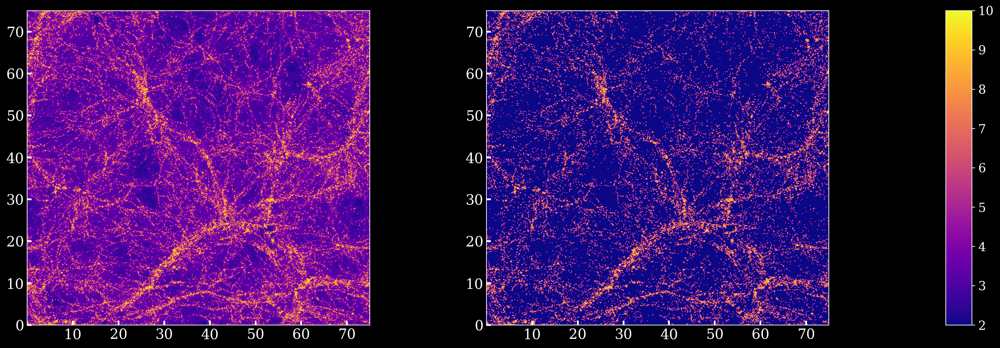

In [44]:
fig

In [45]:
# rlabels = [r'Real Space', r'Redshift Space']
tkw = {'fontsize':20, 'color':'white', 'ha':'left', 'va':'bottom'}
# for i in range(nrows):
#     p = panels[i][0]
#     p.text(0.05, 0.05, rlabels[i], transform = p.transAxes, **tkw)

clabels = ['All Particles', 'Galaxies by Particle', 'Galaxies as Points']
tkw['ha'] = 'center'
tkw['va'] = 'top'
for j in range(ncols - 1):
    p = panels[0][j]
    p.text(0.5, 0.95, clabels[j], transform = p.transAxes, **tkw)
    p.set_ylabel('y (cMpc / h)', color = 'white', fontsize = tkw['fontsize'])
    p.set_xlabel('x (cMpc / h)', color = 'white', fontsize = tkw['fontsize'])
tkw['color'] = 'white'
# fig.text(0.385, 0.05, 'x (cMpc/h)', **tkw)
tkw['va'] = 'center'
tkw['ha'] = 'left'
# fig.text(0, 0.5, 'y (cMpc/h)', rotation = 'vertical', **tkw)
# fig.text(0, 0.27, 's (cMpc/h)', rotation = 'vertical', **tkw)
cbarpos = ((figwidth - .95*panel_length)/figwidth, 0.5)
fig.text(cbarpos[0], cbarpos[1], 'log M$_{\mathrm{HI}}$/M$_\odot$', rotation = 'vertical', fontsize=tkw['fontsize'],
        ha = 'right', va = 'center', color = 'white')

Text(0.7840909090909091, 0.5, 'log M$_{\\mathrm{HI}}$/M$_\\odot$')

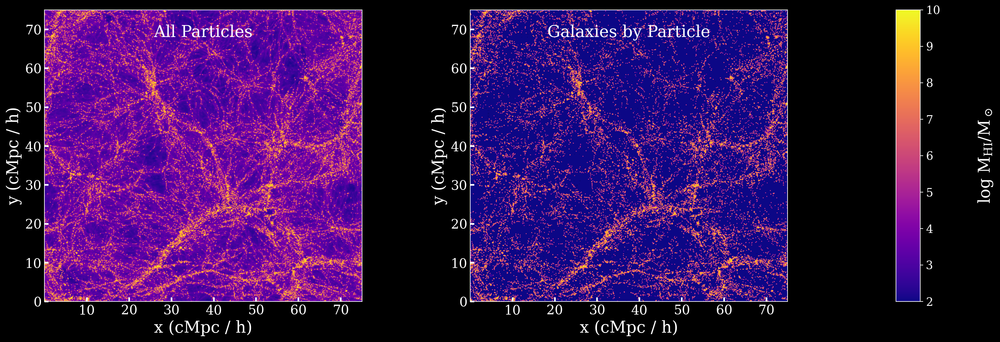

In [46]:
fig

In [48]:
fig.savefig('HIslices_pres.png', facecolor = 'black')

In [12]:
fig.savefig('HIslices_FINAL.pdf')

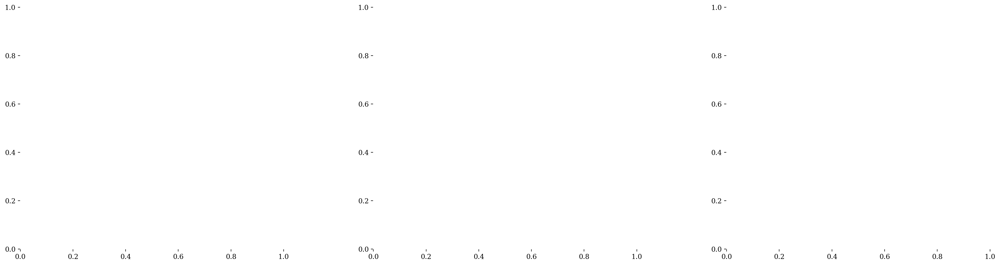

In [49]:
nrows = 1
ncols = 3
xborder = 1
yborder = 1
panel_bt = 2.5
panel_length = 5


# border input can be either a list or single number
if isinstance(xborder, float) or isinstance(xborder, int):
    xborder = [xborder, xborder]
if isinstance(yborder, float) or isinstance(yborder, int):
    yborder = [yborder, yborder]
if isinstance(panel_bt, float) or isinstance(panel_bt, int):
    panel_bt = [panel_bt, panel_bt]
# creating Figure object

figwidth = panel_length * ncols + panel_bt[0] * (ncols - 1) + \
        xborder[0] + xborder[1]
figheight = panel_length * nrows + panel_bt[1] * (nrows - 1) + \
        yborder[0] + yborder[1]

fig = plt.figure(figsize=(figwidth, figheight), dpi = 200)

# creating gridspec
gs = gspec.GridSpec(nrows, ncols)
plt.subplots_adjust(left= xborder[0]/figwidth, right=1-xborder[1]/figwidth,
        top=1-yborder[1]/figheight, bottom=yborder[0]/figheight,
        wspace=panel_bt[0]*ncols/figwidth, hspace=panel_bt[1]*nrows/figheight)

# making panels list
panels = []
for i in range(nrows):
    col_panels = []
    for j in range(ncols):
        col_panels.append(fig.add_subplot(gs[i, j]))

    panels.append(col_panels)

In [84]:
clear_axes()
plt.rcParams['axes.edgecolor'] = 'white'
fig.set_facecolor('black')
vlim = [2, 10]
norm = mpl.colors.Normalize(vmin=vlim[0], vmax=vlim[1])

cmap_name = 'bone'
under = 'k'
cmap = copy.copy(mpl.cm.get_cmap(cmap_name))
cmap.set_under(under)
sm = mpl.cm.ScalarMappable(norm = norm, cmap = cmap)
slices = [vnreal, vnreal, vnred, gdred]
idxs = [(0,0), (0, 1), (1, 0), (1, 1)]
for i in range(2):
    rc = slices[i]
    idx = idxs[i]
    xlim, ylim, data = rc.getValues()
    extent=(xlim[0], xlim[1], ylim[0], ylim[1])
            # x_bound, y_bound, mass = pslice.getValues()
            # extent=(x_bound[0], x_bound[1], y_bound[0], y_bound[1])
    mask = data < norm.vmin
    data[mask] = norm.vmin

    panels[idx[0]][idx[1]].imshow(data, cmap = cmap, norm = norm, aspect = 'auto', extent=extent, 
            origin='lower')

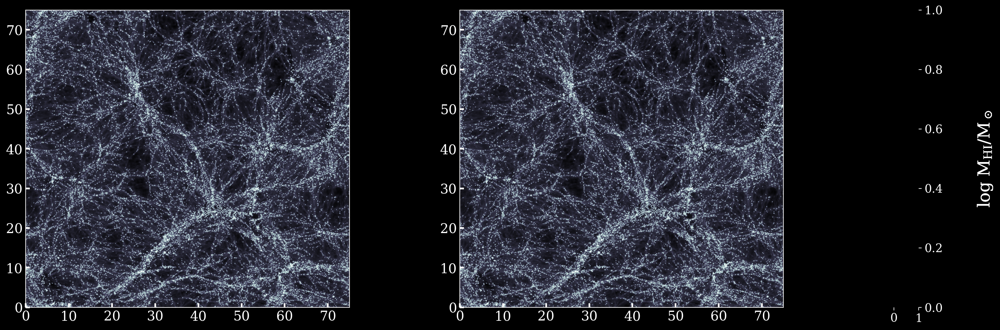

In [85]:
fig

In [86]:
fsize = 16
locs = [10,20,30,40,50,60,70]

for i in range(nrows):
    for j in range(ncols-1):
        p = panels[i][j]
        if j == ncols:
            p.tick_params(labelsize=fsize-2)
        else:
            ticks = p.get_xticks()
            tkw = {'direction' : 'in', 'top':False, 'right' : False, 'reset':True, 'length' : 5, 
                          'width':2,'labelsize':fsize,'colors':'white'}
#             if i == 0:
#                 tkw['labelbottom'] = False
#             if not j == 0:
#                 tkw['labelleft'] = False
            p.tick_params(**tkw)
            
            p.set_xticks(locs)
            p.set_yticks([0]+locs)

            cax = panels[0][2]

            cax.set_aspect(12, anchor='W')
        
cbar = fig.colorbar(sm, cax=cax)
cax.tick_params(labelsize=14, colors = 'white')
# cbar.set_label(r'M$_{\rm{HI}}$ / M$_\odot$', color = 'white', fontsize = 14)
# cax = panels[1][3]
# cax.set_aspect(12, anchor='W')
# cbar = fig.colorbar(sm, cax=cax)
# cax.tick_params(labelsize=14, colors = 'white')
# rlabels = [r'Real Space', r'Redshift Space']
tkw = {'fontsize':20, 'color':'white', 'ha':'left', 'va':'bottom'}
# for i in range(nrows):
#     p = panels[i][0]
#     p.text(0.05, 0.05, rlabels[i], transform = p.transAxes, **tkw)

clabels = ['Red Galaxies', 'Blue Galaxies']
tkw['ha'] = 'center'
tkw['va'] = 'top'
for j in range(ncols - 1):
    p = panels[0][j]
    p.text(0.5, 0.95, clabels[j], transform = p.transAxes, **tkw)
    p.set_ylabel('y (cMpc / h)', color = 'white', fontsize = tkw['fontsize'])
    p.set_xlabel('x (cMpc / h)', color = 'white', fontsize = tkw['fontsize'])
tkw['color'] = 'white'
# fig.text(0.385, 0.05, 'x (cMpc/h)', **tkw)
tkw['va'] = 'center'
tkw['ha'] = 'left'
# fig.text(0, 0.5, 'y (cMpc/h)', rotation = 'vertical', **tkw)
# fig.text(0, 0.27, 's (cMpc/h)', rotation = 'vertical', **tkw)
cbarpos = ((figwidth - .95*panel_length)/figwidth, 0.5)
fig.text(cbarpos[0], cbarpos[1], 'log M$_{\mathrm{HI}}$/M$_\odot$', rotation = 'vertical', fontsize=tkw['fontsize'],
        ha = 'right', va = 'center', color = 'white')

Text(0.7840909090909091, 0.5, 'log M$_{\\mathrm{HI}}$/M$_\\odot$')

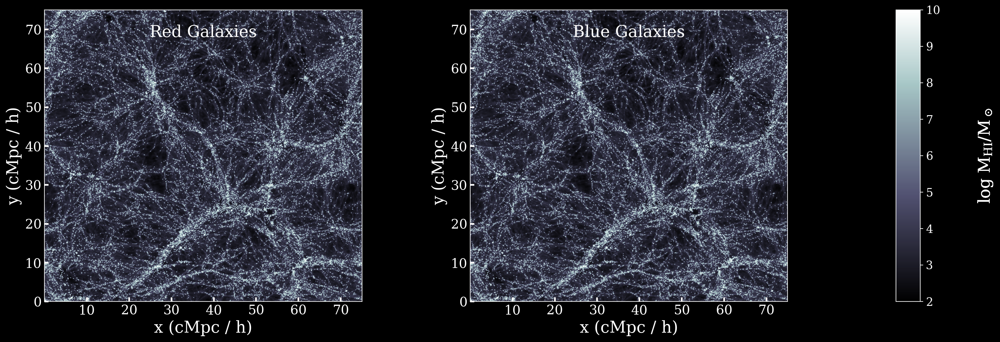

In [87]:
fig

In [88]:
ssp = 'SubhaloStellarPhotometrics'
f = il.groupcat.loadSubhalos(tngpath+'output/', 99, fields=['SubhaloPos', 'SubhaloMassType', ssp])
stmass = f['SubhaloMassType'][:, 4] * 1e10/.6774
resmask = stmass > 2e8
gr = f[ssp][:, 4] - f[ssp][:, 5]
redmask = gr > 0.6
redpos = f['SubhaloPos'][:, :] / 1e3
box = 75
lo = box / 2 - (0.1 * box); hi = 75 / 2 + (0.1 * box)
inslc = (redpos[:, 1] > lo) & (redpos[:, 1] < hi)
tot = resmask & redmask & inslc
lsize = 2
ssize = 1
thresh = 1e12
sizearr = np.zeros(redpos.shape[0])
sizearr[stmass > thresh] = lsize
sizearr[stmass < thresh] = ssize
ax = panels[0][0]
ax.scatter(redpos[tot, 2], redpos[tot, 0], color = 'red', s=sizearr[tot])


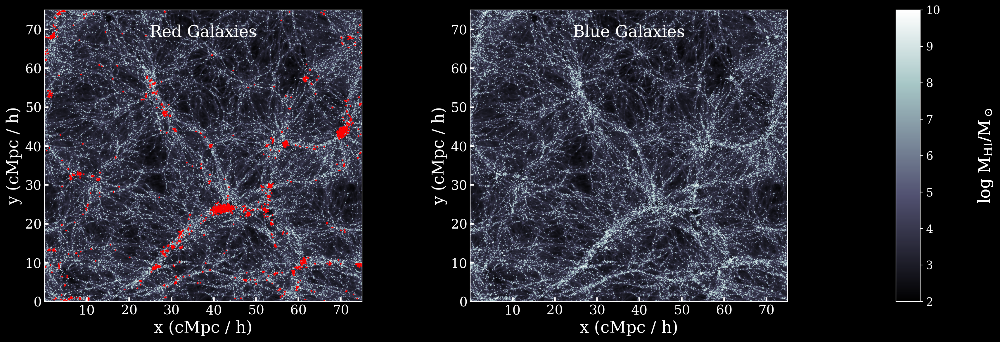

In [89]:
fig

In [92]:
bluemask = gr <= 0.6
redpos = f['SubhaloPos'][:, :] / 1e3
box = 75
lo = box / 2 - (0.1 * box); hi = 75 / 2 + (0.1 * box)
inslc = (redpos[:, 1] > lo) & (redpos[:, 1] < hi)
tot = resmask & bluemask & inslc
lsize = 2
ssize = 1
thresh = 1e12
sizearr = np.zeros(redpos.shape[0])
sizearr[stmass > thresh] = lsize
sizearr[stmass < thresh] = ssize
ax = panels[0][1]
ax.scatter(redpos[tot, 2], redpos[tot, 0], color = 'cyan', s=sizearr[tot])

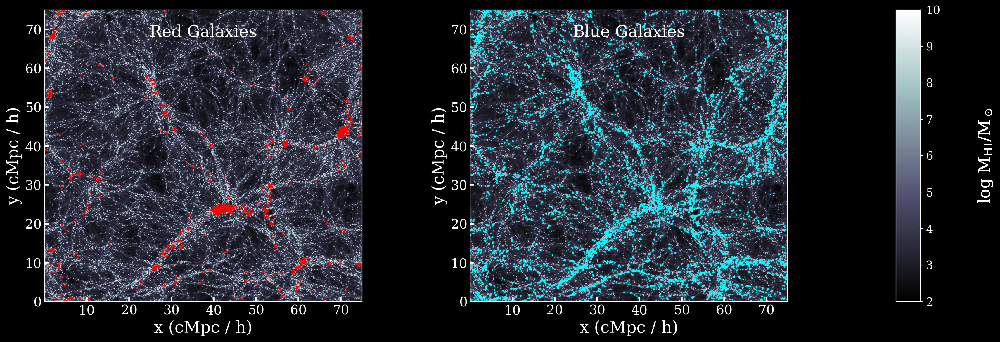

In [93]:
fig

In [94]:
fig.savefig('colorcompare.png', facecolor = 'black')